In [260]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline

# scikit learn dependencies
from sklearn.model_selection import train_test_split, KFold, cross_val_score
from sklearn.preprocessing import MinMaxScaler
from sklearn.feature_selection import SelectKBest, f_regression, mutual_info_regression
from sklearn.pipeline import Pipeline
from sklearn.linear_model import LinearRegression, HuberRegressor
from sklearn.compose import TransformedTargetRegressor

# Parkinsons Telemonitoring

From [UCI Machine Learning Repository](https://archive.ics.uci.edu/ml/datasets/Parkinsons+Telemonitoring), we load the dataset Parkinsons Telemonitoring. This dataset is composed of a range of biomedical voice measurements from 42 people with early-stage Parkinson's disease recruited to a six-month trial of a telemonitoring device for remote symptom progression monitoring.

The main aim of the data is to predict the motor and total UPDRS scores ('motor_UPDRS' and 'total_UPDRS') from the 16 voice measures. Since the prediction is a numeric value, we face a **regression problem**.

In [261]:
# Read dataset
# df = pd.read_csv("https://archive.ics.uci.edu/ml/machine-learning-databases/parkinsons/telemonitoring/parkinsons_updrs.data")
df = pd.read_csv("/content/parkinsons_updrs.data")
df

,subject#,age,sex,test_time,motor_UPDRS,total_UPDRS,Jitter(%),Jitter(Abs),Jitter:RAP,Jitter:PPQ5,Jitter:DDP,Shimmer,Shimmer(dB),Shimmer:APQ3,Shimmer:APQ5,Shimmer:APQ11,Shimmer:DDA,NHR,HNR,RPDE,DFA,PPE
0,1,72,0,5.6431,28.199,34.398,0.00662,0.000034,0.00401,0.00317,0.01204,0.02565,0.230,0.01438,0.01309,0.01662,0.04314,0.014290,21.640,0.41888,0.54842,0.16006
1,1,72,0,12.6660,28.447,34.894,0.00300,0.000017,0.00132,0.00150,0.00395,0.02024,0.179,0.00994,0.01072,0.01689,0.02982,0.011112,27.183,0.43493,0.56477,0.10810
2,1,72,0,19.6810,28.695,35.389,0.00481,0.000025,0.00205,0.00208,0.00616,0.01675,0.181,0.00734,0.00844,0.01458,0.02202,0.020220,23.047,0.46222,0.54405,0.21014
3,1,72,0,25.6470,28.905,35.810,0.00528,0.000027,0.00191,0.00264,0.00573,0.02309,0.327,0.01106,0.01265,0.01963,0.03317,0.027837,24.445,0.48730,0.57794,0.33277
4,1,72,0,33.6420,29.187,36.375,0.00335,0.000020,0.00093,0.00130,0.00278,0.01703,0.176,0.00679,0.00929,0.01819,0.02036,0.011625,26.126,0.47188,0.56122,0.19361
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
5870,42,61,0,142.7900,22.485,33.485,0.00406,0.000031,0.00167,0.00168,0.00500,0.01896,0.160,0.00973,0.01133,0.01549,0.02920,0.025137,22.369,0.64215,0.55314,0.21367
5871,42,61,0,149.8400,21.988,32.988,0.00297,0.000025,0.00119,0.00147,0.00358,0.02315,0.215,0.01052,0.01277,0.01904,0.03157,0.011927,22.886,0.52598,0.56518,0.12621
5872,42,61,0,156.8200,21.495,32.495,0.00349,0.000025,0.00152,0.00187,0.00456,0.02499,0.244,0.01371,0.01456,0.01877,0.04112,0.017701,25.065,0.47792,0.57888,0.14157
5873,42,61,0,163.7300,21.007,32.007,0.00281,0.000020,0.00128,0.00151,0.00383,0.01484,0.131,0.00693,0.00870,0.01307,0.02078,0.007984,24.422,0.56865,0.56327,0.14204


## Data visualization

Some info about the dataset, like data types, size and more.

In [262]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 5875 entries, 0 to 5874
Data columns (total 22 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   subject#       5875 non-null   int64  
 1   age            5875 non-null   int64  
 2   sex            5875 non-null   int64  
 3   test_time      5875 non-null   float64
 4   motor_UPDRS    5875 non-null   float64
 5   total_UPDRS    5875 non-null   float64
 6   Jitter(%)      5875 non-null   float64
 7   Jitter(Abs)    5875 non-null   float64
 8   Jitter:RAP     5875 non-null   float64
 9   Jitter:PPQ5    5875 non-null   float64
 10  Jitter:DDP     5875 non-null   float64
 11  Shimmer        5875 non-null   float64
 12  Shimmer(dB)    5875 non-null   float64
 13  Shimmer:APQ3   5875 non-null   float64
 14  Shimmer:APQ5   5875 non-null   float64
 15  Shimmer:APQ11  5875 non-null   float64
 16  Shimmer:DDA    5875 non-null   float64
 17  NHR            5875 non-null   float64
 18  HNR     

[Pandas profiling](https://github.com/ydataai/pandas-profiling) extends the pandas DataFrame for quick data analysis.

In [ ]:
! pip install https://github.com/pandas-profiling/pandas-profiling/archive/master.zip

from pandas_profiling import ProfileReport

profile = ProfileReport(df, title='Parkinsons Telemonitoring', html={'style':{'full_width':True}})
profile.to_notebook_iframe()

     |████████████████████████████████| 25.9 MB 2.0 MB/s 
     |████████████████████████████████| 10.9 MB 19.9 MB/s 
     |████████████████████████████████| 596 kB 46.6 MB/s 
     |████████████████████████████████| 102 kB 10.4 MB/s 
     |████████████████████████████████| 675 kB 54.2 MB/s 
     |████████████████████████████████| 4.7 MB 51.0 MB/s 
     |████████████████████████████████| 63 kB 1.4 MB/s 
     |████████████████████████████████| 812 kB 52.2 MB/s 
     |████████████████████████████████| 38.1 MB 1.3 MB/s 
  Created wheel for pandas-profiling: filename=pandas_profiling-3.1.1-py2.py3-none-any.whl size=261287 sha256=9a1f381dd58fe44283e2bf96f520282bcc28b4d823a08fa9f0c551b073b7c085
  Stored in directory: /tmp/pip-ephem-wheel-cache-25t9i09p/wheels/cc/d5/09/083fb07c9363a2f45854b0e3a7de7d7c560f07da74b9e9769d
  Created wheel for htmlmin: filename=htmlmin-0.1.12-py3-none-any.whl size=27098 sha256=26182ac64f566d77d7c0c1e19d510436dcaefdfb92150f4ab83ac9f23437d97f
  Stored in directory: /r

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

## Working with the first patient's data

In order to get used to the data we're working on, we extract and analyse the first patient's data.

Since we're working with one person only, we can drop the subject's number, the age and the sex columns. Deleting the last two could be consider as **low variance** feature extraction.

In [263]:
# first patient sub-dataset
subject1_df = df.loc[df['subject#'] == 1]

# drop irrelevant variables
subject1_df.drop(['subject#', 'age', 'sex'], axis=1, inplace=True)
subject1_df

/usr/local/lib/python3.7/dist-packages/pandas/core/frame.py:4913: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  errors=errors,


,test_time,motor_UPDRS,total_UPDRS,Jitter(%),Jitter(Abs),Jitter:RAP,Jitter:PPQ5,Jitter:DDP,Shimmer,Shimmer(dB),Shimmer:APQ3,Shimmer:APQ5,Shimmer:APQ11,Shimmer:DDA,NHR,HNR,RPDE,DFA,PPE
0,5.6431,28.199,34.398,0.00662,0.000034,0.00401,0.00317,0.01204,0.02565,0.230,0.01438,0.01309,0.01662,0.04314,0.014290,21.640,0.41888,0.54842,0.16006
1,12.6660,28.447,34.894,0.00300,0.000017,0.00132,0.00150,0.00395,0.02024,0.179,0.00994,0.01072,0.01689,0.02982,0.011112,27.183,0.43493,0.56477,0.10810
2,19.6810,28.695,35.389,0.00481,0.000025,0.00205,0.00208,0.00616,0.01675,0.181,0.00734,0.00844,0.01458,0.02202,0.020220,23.047,0.46222,0.54405,0.21014
3,25.6470,28.905,35.810,0.00528,0.000027,0.00191,0.00264,0.00573,0.02309,0.327,0.01106,0.01265,0.01963,0.03317,0.027837,24.445,0.48730,0.57794,0.33277
4,33.6420,29.187,36.375,0.00335,0.000020,0.00093,0.00130,0.00278,0.01703,0.176,0.00679,0.00929,0.01819,0.02036,0.011625,26.126,0.47188,0.56122,0.19361
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
144,145.6400,35.043,45.390,0.00219,0.000012,0.00104,0.00104,0.00311,0.00960,0.084,0.00471,0.00499,0.00733,0.01412,0.002408,28.183,0.40955,0.54892,0.10926
145,152.6500,35.510,46.013,0.00378,0.000020,0.00176,0.00209,0.00527,0.02038,0.232,0.01056,0.01152,0.01346,0.03169,0.013739,25.078,0.41783,0.53659,0.17886
146,159.6400,35.976,46.635,0.00237,0.000012,0.00085,0.00087,0.00256,0.01177,0.131,0.00465,0.00552,0.01070,0.01396,0.015931,28.224,0.40007,0.52887,0.13589
147,166.6400,36.443,47.257,0.00224,0.000012,0.00092,0.00082,0.00276,0.00922,0.081,0.00471,0.00466,0.00735,0.01413,0.008040,29.250,0.40794,0.54068,0.10370


We analize the base statistics description and correlation matrix of the first patient's data normalized with MinMax scaler. There we can see that there are not low variance variables.

In [264]:
scaler = MinMaxScaler()
scaler.fit(subject1_df)
norm_df = pd.DataFrame(scaler.transform(subject1_df))
norm_df.describe().transpose()

,count,mean,std,min,25%,50%,75%,max
0,149.0,0.494234,0.299232,0.0,0.248531,0.496944,0.745469,1.0
1,149.0,0.421453,0.303805,0.0,0.168926,0.354254,0.673311,1.0
2,149.0,0.466785,0.300171,0.0,0.218464,0.443118,0.718243,1.0
3,149.0,0.307990,0.188870,0.0,0.163592,0.268143,0.410824,1.0
4,149.0,0.295855,0.176908,0.0,0.172118,0.274232,0.372756,1.0
5,149.0,0.307715,0.234114,0.0,0.134409,0.258065,0.413978,1.0
6,149.0,0.255511,0.179512,0.0,0.127155,0.221983,0.364224,1.0
7,149.0,0.308538,0.234123,0.0,0.135305,0.258961,0.413978,1.0
8,149.0,0.277734,0.196553,0.0,0.127933,0.253116,0.353556,1.0
9,149.0,0.308281,0.205818,0.0,0.152305,0.278557,0.422846,1.0


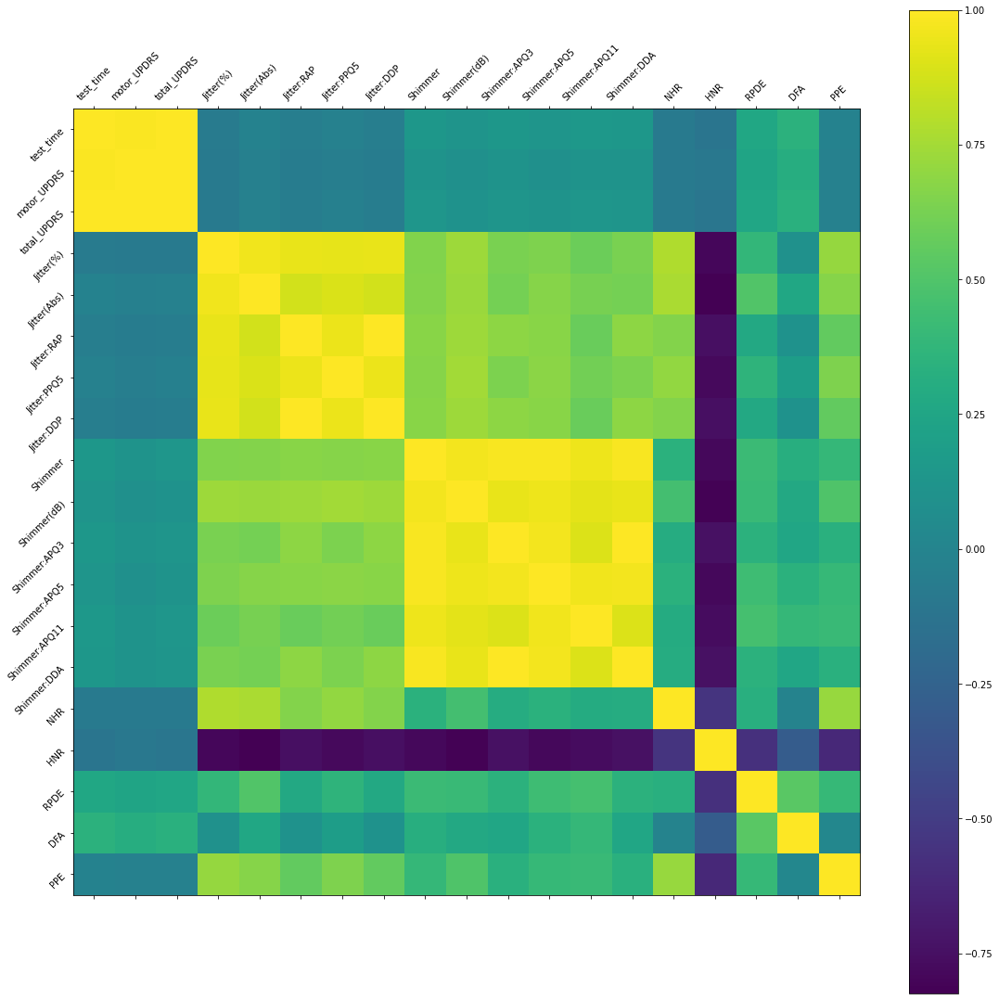

In [265]:
subject1_corr = subject1_df.corr()

# Correlation plot
f = plt.figure(figsize=subject1_corr.shape)
plt.matshow(subject1_corr, fignum=f.number)
plt.xticks(range(subject1_corr.shape[0]), subject1_corr.columns,
           fontsize=10, rotation=45)
plt.yticks(range(subject1_corr.shape[1]), subject1_corr.columns,
           fontsize=10, rotation=45)
cb = plt.colorbar()

From the correlation matrices obtained both for the first patient and the whole dataset (with pandas profiling), by visual inspection we can see that all Jitter measures are correlated with each other. Same happens with the Shimmer measures and between the `motor_UPDRS` and `total_UPDRS` variables (both target variables). We also see that the variable HNR almost has an inverse relation with the Jitter and Shimmer variables.

### Feaure extraction for first patient data only

First we prepare the data for the process of feature extraction. We buid the y (target variables) and the X matrices since we are trying to find a model that will represent the relation $y=f(X)$. Then we split the dataset in both train and test sets.

In [281]:
y = subject1_df['total_UPDRS']
X = subject1_df.drop(['motor_UPDRS', 'total_UPDRS'], axis=1)

# split into train and test sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.33, random_state=1)

#### Correlation feature selection
The scikit-learn machine library provides an implementation of the correlation statistic in the `f_regression()` function. This function can be used in a feature selection strategy, such as selecting the top k most relevant features (largest values) via the [SelectKBest](https://scikit-learn.org/stable/modules/generated/sklearn.feature_selection.SelectKBest.html) class.

Index(['test_time', 'Jitter(%)', 'Jitter(Abs)', 'Jitter:RAP', 'Jitter:PPQ5',
       'Jitter:DDP', 'Shimmer', 'Shimmer(dB)', 'Shimmer:APQ3', 'Shimmer:APQ5',
       'Shimmer:APQ11', 'Shimmer:DDA', 'NHR', 'HNR', 'RPDE', 'DFA', 'PPE'],
      dtype='object')

Selected Features:
Index(['test_time', 'Shimmer:APQ11', 'RPDE', 'DFA'], dtype='object')


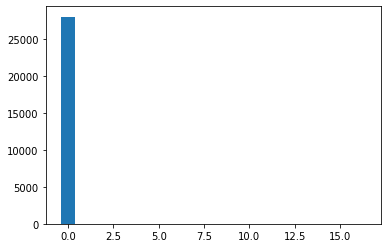

In [282]:
# configure to select k features
fs = SelectKBest(score_func=f_regression, k=4)
# learn relationship from training data
fs.fit(X_train, y_train)

#Selected features
cols = fs.get_support(indices=True)
attributes = X.columns[cols]
print(X.columns)
print("\nSelected Features:")
print(attributes)

# plot the scores for the features
plt.bar([i for i in range(len(fs.scores_))], fs.scores_)
plt.show()

We can see how the `test_time` variable is "the most relevant. Yet the description for the variable is:

> test_time - Time since recruitment into the trial. The integer part is the number of days since recruitment.

And that doesn't seem relevant to the result we're aiming. So we delete that feature and recalculate the k best.

Index(['Jitter(%)', 'Jitter(Abs)', 'Jitter:RAP', 'Jitter:PPQ5', 'Jitter:DDP',
       'Shimmer', 'Shimmer(dB)', 'Shimmer:APQ3', 'Shimmer:APQ5',
       'Shimmer:APQ11', 'Shimmer:DDA', 'NHR', 'HNR', 'RPDE', 'DFA', 'PPE'],
      dtype='object')

Selected Features:
Index(['Shimmer', 'Shimmer:APQ11', 'RPDE', 'DFA'], dtype='object')


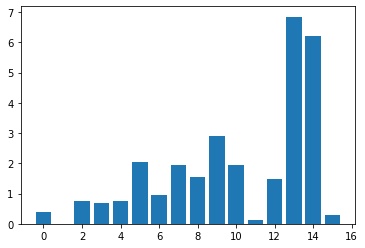

In [283]:
X = subject1_df.drop(['motor_UPDRS', 'total_UPDRS', 'test_time'], axis=1)
# split into train and test sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.33, random_state=1)

# configure to select k features
fs = SelectKBest(score_func=f_regression, k=4)
# learn relationship from training data
fs.fit(X_train, y_train)

#Selected features
cols = fs.get_support(indices=True)
attributes = X.columns[cols]
print(X.columns)
print("\nSelected Features:")
print(attributes)

# plot the scores for the features
plt.bar([i for i in range(len(fs.scores_))], fs.scores_)
plt.show()

Now we can see how relevant are the rest of variables. We can take the three most relevant that are: `DFA`,`RPDE` y `Shimmer:APQ11`.

### Mutual Information Feature Selection

Mutual information from the field of information theory is the application of information gain (typically used in the construction of decision trees) to feature selection.

Mutual information is calculated between two variables and measures the reduction in uncertainty for one variable given a known value of the other variable.

Index(['Jitter(%)', 'Jitter(Abs)', 'Jitter:RAP', 'Jitter:PPQ5', 'Jitter:DDP',
       'Shimmer', 'Shimmer(dB)', 'Shimmer:APQ3', 'Shimmer:APQ5',
       'Shimmer:APQ11', 'Shimmer:DDA', 'NHR', 'HNR', 'RPDE', 'DFA', 'PPE'],
      dtype='object')

Selected Features:
Index(['Shimmer', 'Shimmer(dB)', 'Shimmer:APQ5', 'Shimmer:APQ11'], dtype='object')


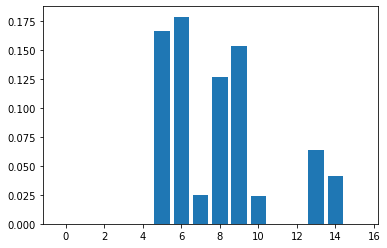

In [286]:
# configure to select k features
fs = SelectKBest(score_func=mutual_info_regression, k=4)
# learn relationship from training data
fs.fit(X_train, y_train)

#Selected features
cols = fs.get_support(indices=True)
attributes = X.columns[cols]
print(X.columns)
print("\nSelected Features:")
print(attributes)

# what are scores for the features
plt.bar([i for i in range(len(fs.scores_))], fs.scores_)
plt.show()

We can take the four most relevant that are: `Shimmer:APQ11`, `Shimmer:APQ5`, `Shimmer(dB)` y `Shimmer`. From the dataset info we know that they are several measures of variation in amplitude

### Normalization and training a model for first patient data only

In [316]:
y = subject1_df[['total_UPDRS']]
# all features
#X = subject1_df.drop(['motor_UPDRS', 'total_UPDRS', 'test_time'], axis=1)
# correlation features
#X = subject1_df[['Shimmer:APQ11', 'RPDE', 'DFA']]
# mutual information features
#X = subject1_df[['Shimmer', 'Shimmer(dB)', 'Shimmer:APQ5', 'Shimmer:APQ11']]
# correlation and mutual information features
#X = subject1_df[['Shimmer', 'Shimmer(dB)', 'Shimmer:APQ5', 'Shimmer:APQ11', 'RPDE', 'DFA']]
# manual selection
X = subject1_df[['Jitter:DDP', 'Shimmer:APQ11', 'NHR', 'HNR', 'RPDE', 'DFA', 'PPE']]

The [MinMaxScaler](https://scikit-learn.org/stable/modules/generated/sklearn.preprocessing.MinMaxScaler.html) estimator scales and translates each feature individually such that it's in the given range on the training set. The [Pipeline](https://scikit-learn.org/stable/modules/generated/sklearn.pipeline.Pipeline.html) will fit the scale objects on the training data and apply the transform to new data, such as when using a model to make a prediction.

The first model will be an ordinary least squares [Linear Regression](https://scikit-learn.org/stable/modules/generated/sklearn.linear_model.LinearRegression.html).

The [TransformedTargetRegressor](https://scikit-learn.org/stable/modules/generated/sklearn.compose.TransformedTargetRegressor.html) is a meta-estimator to regress on a transformed target. Useful for applying a non-linear transformation to the target y in regression problems like this.

In [310]:
# prepare the model with input scaling
pipeline = Pipeline(steps=[('normalize', MinMaxScaler()), ('model', LinearRegression())])
#pipeline = Pipeline(steps=[('normalize', MinMaxScaler()), ('model', HuberRegressor())])

# prepare the model with target scaling
model = TransformedTargetRegressor(regressor=pipeline, transformer=MinMaxScaler())

[KFold](https://scikit-learn.org/stable/modules/generated/sklearn.model_selection.KFold.html) provides train/test indices to split data in train/test sets. Split dataset into k consecutive folds. Each fold is then used once as a validation while the k - 1 remaining folds form the training set.

Then we perform cross-validation.

Mean R2: 0.192


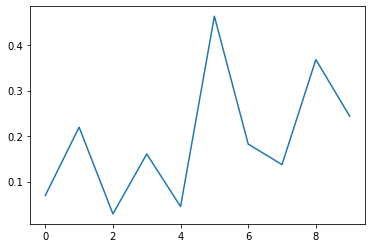

In [317]:
# evaluate model
cv = KFold(n_splits=10, shuffle=True, random_state=1)
# scores = cross_val_score(model, X, y, scoring='neg_mean_absolute_error', cv=cv, n_jobs=-1)
scores = cross_val_score(model, X, y, scoring='r2', cv=cv, n_jobs=-1)
# convert scores to positive
scores = np.absolute(scores)
plt.plot(scores)
# summarize the result
s_mean = np.mean(scores)
print('Mean R2: %.3f' % (s_mean))

First results are:

|Features| $R^{2}$ |
|--------|-------|
| Correlation | 0.173 | 
| Mutual information | 0.124 |
| Both | 0.207 |
| All | 0.196 |
| Manual selection | 0.192 |

## Dataset for all patients

In [205]:
y = df['total_UPDRS']
X = df.drop(['motor_UPDRS', 'total_UPDRS', 'subject#', 'test_time'], axis=1)

In [206]:
from sklearn.model_selection import train_test_split

# split into train and test sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.33, random_state=1)

## Feature selection with all patients in consideration

Now we analize if the age and sex are relevant variables for the model. 

Index(['age', 'sex', 'Jitter(%)', 'Jitter(Abs)', 'Jitter:RAP', 'Jitter:PPQ5',
       'Jitter:DDP', 'Shimmer', 'Shimmer(dB)', 'Shimmer:APQ3', 'Shimmer:APQ5',
       'Shimmer:APQ11', 'Shimmer:DDA', 'NHR', 'HNR', 'RPDE', 'DFA', 'PPE'],
      dtype='object')

Selected Features:
Index(['age', 'sex', 'Shimmer(dB)', 'Shimmer:APQ11', 'HNR', 'RPDE', 'DFA',
       'PPE'],
      dtype='object')
Feature 0: 409.656101
Feature 1: 42.622198
Feature 2: 20.321674
Feature 3: 18.236588
Feature 4: 15.206819
Feature 5: 14.415329
Feature 6: 15.223400
Feature 7: 35.652204
Feature 8: 39.550756
Feature 9: 28.050307
Feature 10: 29.479891
Feature 11: 61.715415
Feature 12: 28.050463
Feature 13: 14.957709
Feature 14: 111.448187
Feature 15: 95.319875
Feature 16: 55.964234
Feature 17: 99.323502


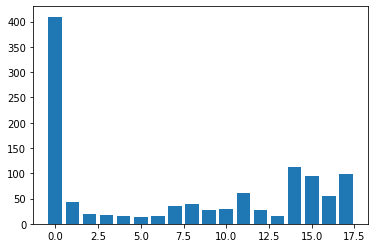

In [207]:
from sklearn.feature_selection import SelectKBest, f_regression

# configure to select all features
fs = SelectKBest(score_func=f_regression, k=8)
# learn relationship from training data
fs.fit(X_train, y_train)
# transform train input data
X_train_fs = fs.transform(X_train)
# transform test input data
X_test_fs = fs.transform(X_test)

#Selected features
cols = fs.get_support(indices=True)
attributes = X.columns[cols]
print(X.columns)
print("\nSelected Features:")
print(attributes)

# what are scores for the features
plt.bar([i for i in range(len(fs.scores_))], fs.scores_)
plt.show()

Index(['age', 'sex', 'Jitter:PPQ5', 'Shimmer:APQ11', 'HNR', 'RPDE', 'DFA',
       'PPE'],
      dtype='object')

Selected Features:
Index(['age', 'sex'], dtype='object')
Feature 0: 2.532822
Feature 1: 0.481178
Feature 2: 0.063493
Feature 3: 0.102117
Feature 4: 0.068398
Feature 5: 0.101124
Feature 6: 0.067816
Feature 7: 0.091528
Feature 8: 0.083063
Feature 9: 0.093442
Feature 10: 0.090070
Feature 11: 0.112408
Feature 12: 0.092805
Feature 13: 0.070603
Feature 14: 0.103102
Feature 15: 0.064316
Feature 16: 0.195720
Feature 17: 0.071881


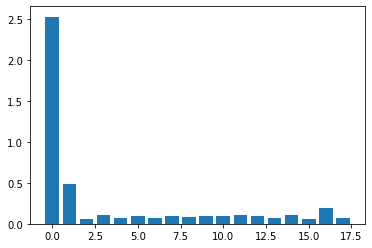

In [229]:
from sklearn.feature_selection import SelectKBest, mutual_info_regression

# configure to select all features
fs = SelectKBest(score_func=mutual_info_regression, k=2)
# learn relationship from training data
fs.fit(X_train, y_train)
# transform train input data
X_train_fs = fs.transform(X_train)
# transform test input data
X_test_fs = fs.transform(X_test)

#Selected features
cols = fs.get_support(indices=True)
attributes = X.columns[cols]
print(X.columns)
print("\nSelected Features:")
print(attributes)

# what are scores for the features
plt.bar([i for i in range(len(fs.scores_))], fs.scores_)
plt.show()

## Training a model for the whole dataset

In [254]:
y = df[['total_UPDRS']]
#X = df.drop(['motor_UPDRS', 'total_UPDRS'], axis=1)
X = df[['age', 'sex', 'Jitter:PPQ5', 'Shimmer:APQ11', 'HNR', 'RPDE', 'DFA', 'PPE']]
#X = df[['test_time']]

In [255]:
from sklearn.pipeline import Pipeline
from sklearn.preprocessing import MinMaxScaler, PowerTransformer
from sklearn.linear_model import LinearRegression, HuberRegressor
from sklearn.svm import SVR
from sklearn.compose import TransformedTargetRegressor
from sklearn.model_selection import KFold, cross_val_score

mod = SVR(kernel="rbf", C=100, gamma=0.1, epsilon=0.1)
trn = PowerTransformer()

# prepare the model with input scaling
#pipeline = Pipeline(steps=[('normalize', MinMaxScaler()), ('model', LinearRegression())])
pipeline = Pipeline(steps=[('power', PowerTransformer()), ('model', mod)])

# prepare the model with target scaling
#model = TransformedTargetRegressor(regressor=pipeline, transformer=MinMaxScaler())
model = TransformedTargetRegressor(regressor=pipeline, transformer=PowerTransformer())

# evaluate model
cv = KFold(n_splits=10, shuffle=True, random_state=1)
# scores = cross_val_score(model, X, y, scoring='neg_mean_absolute_error', cv=cv, n_jobs=-1)
scores = cross_val_score(model, X, y, scoring='r2', cv=cv, n_jobs=-1)

Mean R2: 0.610


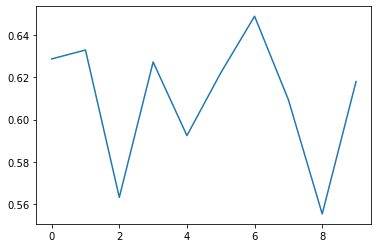

In [258]:
import numpy as np

# convert scores to positive
scores = np.absolute(scores)
plt.plot(scores)
# summarize the result
s_mean = np.mean(scores)
print('Mean R2: %.3f' % (s_mean))

# Relevant links
- [How to Perform Feature Selection for Regression Data](https://machinelearningmastery.com/feature-selection-for-regression-data/)
- [How to Transform Target Variables for Regression in Python](https://machinelearningmastery.com/how-to-transform-target-variables-for-regression-with-scikit-learn/)